##                                                Beni Food Prescriptive analytics Proj

In [36]:
%pip install statsmodels


[notice] A new release of pip is available: 24.3.1 -> 25.1.1
[notice] To update, run: pip3 install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [37]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

import seaborn as sns
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 10, 6
from statsmodels.tsa.seasonal import seasonal_decompose




In [38]:
df = pd.read_csv("deptsales_by_day.csv", encoding='utf-8')
df.head()

,Date,Department,Baskets,Items,Avg_Items,Sales,Avg_Sale,Scan_Rate,Scan_Sales
0,2020-11-18,General Food,2,2,1.0,15.0,7.50,50.0,5.0
1,2020-11-18,Misc.,1,1,1.0,15.0,15.00,100.0,15.0
2,2020-11-20,General Food,4,6,1.5,19.5,4.87,100.0,19.5
3,2020-11-20,Misc.,1,1,1.0,15.0,15.00,100.0,15.0
4,2020-11-22,General Food,6,35,5.8,253.0,42.16,100.0,253.0


In [39]:
food_df = pd.read_csv("food_name.csv", encoding = 'utf-8')
pd.set_option("display.max_row", None)

In [40]:
df2 = pd.read_csv("deptsales_by_day.csv", encoding='utf-8')

### preprocessing a categorical column

In [41]:
#counting the amount of time each feature appears in its column
df.Department.value_counts()


Department
General Food           1333
Meat/Fish               993
Drinks                  892
Service Fees            700
Snacks                  632
Cleaning&body           353
Pinless Recharge        239
Household               105
Condiments               65
Clothes                  59
Frozen                   59
Pasta/Rice               33
Misc.                    25
Vitamins/Medicine         9
Hygiene Feminine          8
Calling Card              5
Tobacco                   5
Cleaning                  5
Dairy                     2
Grocery Non-Taxable       2
Name: count, dtype: int64

In [42]:
df_food1 = df.drop(columns = ["Scan_Rate", "Baskets", "Avg_Items", "Avg_Sale", "Sales"])
df_food1.head()

,Date,Department,Items,Scan_Sales
0,2020-11-18,General Food,2,5.0
1,2020-11-18,Misc.,1,15.0
2,2020-11-20,General Food,6,19.5
3,2020-11-20,Misc.,1,15.0
4,2020-11-22,General Food,35,253.0


In [43]:
dept_forecast = df.drop(columns= ["Scan_Rate", "Baskets", "Avg_Items", "Avg_Sale", "Scan_Sales", "Department", "Items"])
dept_forecast.head()

,Date,Sales
0,2020-11-18,15.0
1,2020-11-18,15.0
2,2020-11-20,19.5
3,2020-11-20,15.0
4,2020-11-22,253.0


In [44]:
#'ISO8601'

In [45]:
#here we are converting the date column into a date time object
dept_forecast["Date"] = pd.to_datetime(dept_forecast["Date"], infer_datetime_format=True)
#Here were we will put date into an index
indexDataset = dept_forecast.set_index(["Date"])
# dept_forecast.index=dept_forecast["Date"]

# dept_forecast


/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/4029695706.py:2: UserWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  dept_forecast["Date"] = pd.to_datetime(dept_forecast["Date"], infer_datetime_format=True)


In [46]:
from datetime import datetime
indexDataset.head()

,Sales
Date,
2020-11-18,15.0
2020-11-18,15.0
2020-11-20,19.5
2020-11-20,15.0
2020-11-22,253.0


In [47]:
from datetime import datetime

if not indexDataset.empty:
    dept_forecast["Date"] = pd.to_datetime(dept_forecast["Date"])
    filtered_data = dept_forecast[dept_forecast["Date"] <= datetime(2021,12,31)]
    print(filtered_data.head())

        Date  Sales
0 2020-11-18   15.0
1 2020-11-18   15.0
2 2020-11-20   19.5
3 2020-11-20   15.0
4 2020-11-22  253.0


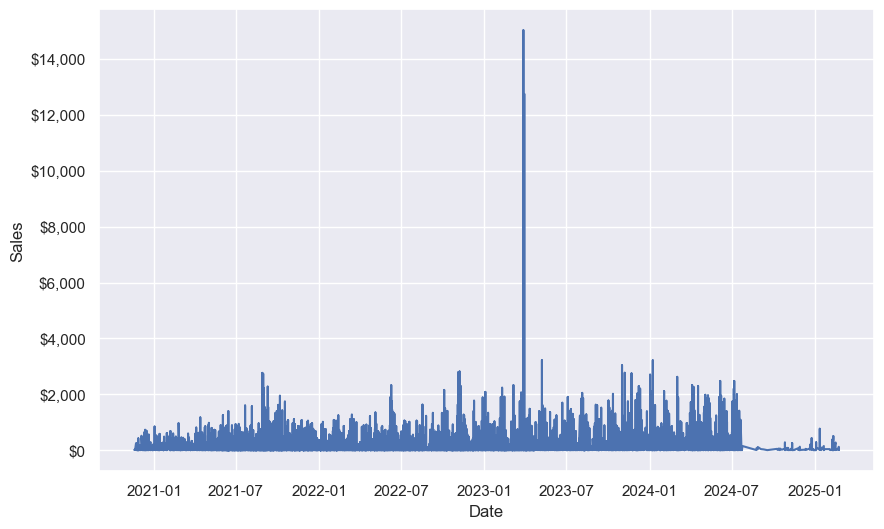

In [48]:
##plot the graph
plt.xlabel("Date")
plt.ylabel("Sales")
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas
plt.plot(indexDataset)

In [49]:
rolmean = indexDataset.rolling(window=365).mean()

rolstd = indexDataset.rolling(window=365).std()
print(rolmean, rolstd)

                 Sales
Date                  
2020-11-18         NaN
2020-11-18         NaN
2020-11-20         NaN
2020-11-20         NaN
2020-11-22         NaN
2020-11-22         NaN
2020-11-23         NaN
2020-11-23         NaN
2020-11-24         NaN
2020-11-24         NaN
2020-11-24         NaN
2020-11-25         NaN
2020-11-25         NaN
2020-11-25         NaN
2020-11-25         NaN
2020-11-26         NaN
2020-11-26         NaN
2020-11-27         NaN
2020-11-27         NaN
2020-11-27         NaN
2020-11-27         NaN
2020-11-27         NaN
2020-11-28         NaN
2020-11-28         NaN
2020-11-28         NaN
2020-11-29         NaN
2020-11-30         NaN
2020-12-01         NaN
2020-12-01         NaN
2020-12-02         NaN
2020-12-03         NaN
2020-12-03         NaN
2020-12-04         NaN
2020-12-04         NaN
2020-12-05         NaN
2020-12-06         NaN
2020-12-06         NaN
2020-12-07         NaN
2020-12-07         NaN
2020-12-07         NaN
2020-12-08         NaN
2020-12-08 

### A rolling analysis of a time series model is often used to assess the model's stability over time. When analyzing financial time series data using a statistical model, a key assumption is that the parameters of the model are constant over time

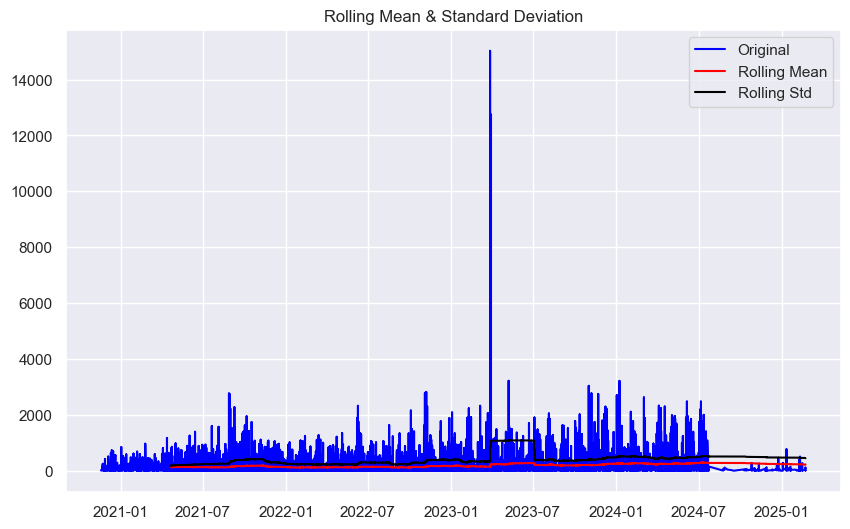

In [ ]:
# #plot rolling statistic
# original = plt.plot(indexDataset, color ='blue', label ='Original')
# mean = plt.plot(rolmean, color='red', label ='Rolling Mean')
# std = plt.plot(rolstd, color='black', label = 'Rolling Std')
# plt.legend(loc='best')
# plt.title('Rolling Mean & Standard Deviation')
# plt.show(block=False)

### ARIMA

In [51]:
dept_forecast.head()

,Date,Sales
0,2020-11-18,15.0
1,2020-11-18,15.0
2,2020-11-20,19.5
3,2020-11-20,15.0
4,2020-11-22,253.0


In [52]:
dept_forecast.index = pd.to_datetime(dept_forecast['Date'], format='%Y-%m-%d')
dept_forecast.index

DatetimeIndex(['2020-11-18', '2020-11-18', '2020-11-20', '2020-11-20',
               '2020-11-22', '2020-11-22', '2020-11-23', '2020-11-23',
               '2020-11-24', '2020-11-24',
               ...
               '2025-02-15', '2025-02-15', '2025-02-15', '2025-02-15',
               '2025-02-15', '2025-02-21', '2025-02-21', '2025-02-22',
               '2025-02-22', '2025-02-22'],
              dtype='datetime64[ns]', name='Date', length=5524, freq=None)

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns

In [54]:
sns.set()

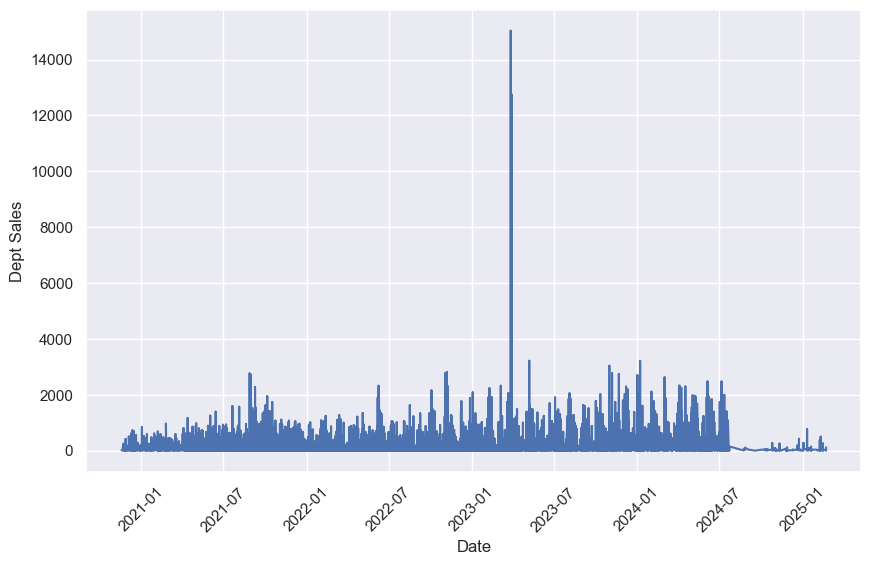

In [55]:
plt.ylabel('Dept Sales')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.plot(dept_forecast.index, dept_forecast['Sales'], )

#### Splitting data  for training and testing

In [56]:
# train = dept_forecast[dept_forecast.index < pd.to_datetime("2023-12-31", format='%Y-%m-%d')]
# test = dept_forecast[dept_forecast.index > pd.to_datetime("2023-12-31", format='%Y-%m-%d')]

# plt.plot(train, color = "black")
# plt.plot(test, color = "red")
# plt.ylabel('Dept Sales')
# plt.xlabel('Date')
# plt.xticks(rotation=45)
# plt.title("Train/Test split for BeniFood Department Sales Data")
# plt.show()

In [57]:
# from statsmodels.tsa.statespace.sarimax import SARIMAX


In [58]:
# y = train['Sales']
# y

order=(p, d, q) — Non-seasonal part
p = number of autoregressive terms (AR):
The model will use the past p observations to predict the current value.

d = number of differencing operations (I, for Integrated):
How many times the series is differenced to make it stationary.

q = number of moving average terms (MA):
The model will use the past q error terms to predict the current value.

seasonal_order=(P, D, Q, s) — Seasonal part
P = number of seasonal autoregressive terms (seasonal AR)

D = number of seasonal differencing operations

Q = number of seasonal moving average terms (seasonal MA)

s = length of the seasonal cycle (e.g., s=12 for monthly data with yearly seasonality)

In [59]:
# ARMAmodel = SARIMAX(y, order = (1, 0, 1))
# ARMAmodel

In [60]:
# ARMAmodel = ARMAmodel.fit()

### When comparing which model is most accurate in predicitng the trends we look at the Log Likelihood and AIC, so if a model has a higher likelihood and lower AIC than it is considered have the better performance.

### The log-likelihood value provides a measure of how well a statistical model fits the data. A higher log-likelihood value generally indicates a better-fitting model.

### In time series analysis, the Akaike Information Criterion (AIC) is a statistical measure used to evaluate the goodness of fit of different models. It balances model fit with model complexity, helping to select the best-fitting model for forecasting without overfitting the data



## ARMA — Baseline Model, A moving average that is autoregressive is called an ARMA. It combines Autoregressive with Moving Average

In [61]:
# y_pred = ARMAmodel.get_forecast(len(test.index))
# y_pred_df = y_pred.conf_int(alpha = 0.05) 
# y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], end = y_pred_df.index[-1])
# y_pred_df.index = test.index
# y_pred_out = y_pred_df["Predictions"]

# plt.plot(y_pred_out, color='green', label = 'Predictions')
# plt.legend()

In [62]:
# ARMAmodel.summary()

In [63]:
# from statsmodels.tsa.arima.model import ARIMA

## ARIMA (Autoregressive Integrated Moving Average) models are used for time series data that may require differencing to achieve stationarity

In [64]:
# from statsmodels.tsa.arima.model import ARIMA
# ARIMA_model = ARIMA(dept_forecast['Sales'], order=(1, 0, 1)).fit()
# ARIMA_model.summary()

In [65]:
# ARIMAmodel = ARIMA(y, order = (2, 2, 2))
# ARIMAmodel = ARIMAmodel.fit()

# y_pred = ARIMAmodel.get_forecast(len(test.index))
# y_pred_df = y_pred.conf_int(alpha = 0.05) 
# y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0], end = y_pred_df.index[-1])
# y_pred_df.index = test.index
# y_pred_out = y_pred_df["Predictions"] 
# plt.plot(y_pred_out, color='Yellow', label = 'ARIMA Predictions')
# plt.legend()

# import numpy as np
# from sklearn.metrics import mean_squared_error


In [66]:
# ARIMA_model.summary()

In [67]:
# #Root mean squared error
# arma_rmse = np.sqrt(mean_squared_error(test["Sales"].values, y_pred_df["Predictions"]))
# print("RMSE: ",arma_rmse)

## SARIMA (Seasonal ARIMA) models extend ARIMA by including seasonal components, making them suitable for time series data with seasonal patterns

In [68]:
# from numpy.linalg import LinAlgError
# from scipy.linalg import lu_factor, lu_solve

In [69]:
# SARIMAXmodel = SARIMAX(y, order = (5, 4, 2), seasonal_order=(2,2,2,12))
# SARIMAXmodel = SARIMAXmodel.fit()

# y_pred = SARIMAXmodel.get_forecast(len(test.index))
# y_pred_df = y_pred.conf_int(alpha = 0.05) 
# y_pred_df["Predictions"] = SARIMAXmodel.predict(start = y_pred_df.index[0], end = y_pred_df.index[-1])
# y_pred_df.index = test.index
# y_pred_out = y_pred_df["Predictions"]
# plt.plot(y_pred_out, color='Blue', label = 'SARIMA Predictions')
# plt.legend()

In [70]:
# SARIMAXmodel.summary()

In [72]:
# # Step 1: Ensure 'date' column is datetime.date (not datetime64)
# dept_forecast['Date'] = pd.to_datetime(dept_forecast['Date']).dt.date

# # Step 2: Split the data
# split_date = datetime.date(2022, 12, 31)  # import datetime if needed

# train = dept_forecast[dept_forecast['Date'] < split_date]
# test = dept_forecast[dept_forecast['Date'] > split_date]

# # Step 3: Plot
# plt.plot(train['Date'], train['Sales'], color="black", label="Train")
# plt.plot(test['Date'], test['Sales'], color="red", label="Test")
# plt.ylabel('BeniFood Sales')
# plt.xlabel('Date')
# plt.xticks(rotation=45)
# plt.title("Train/Test split for BeniFood Department Sales Data")
# plt.legend()
# plt.tight_layout()
# # plt.show()


In [ ]:

# #here we are converting the date column into a date time object
# dept_forecast["Date"] = pd.to_datetime(dept_forecast["Date"], format='ISO8601')
# dept_forecast["Date"]
# #Here were we will put date into an index
# dept_forecast.index=dept_forecast["Date"]
# del dept_forecast["Date"]
# dept_forecast


Text(0, 0.5, 'Number of Departments')

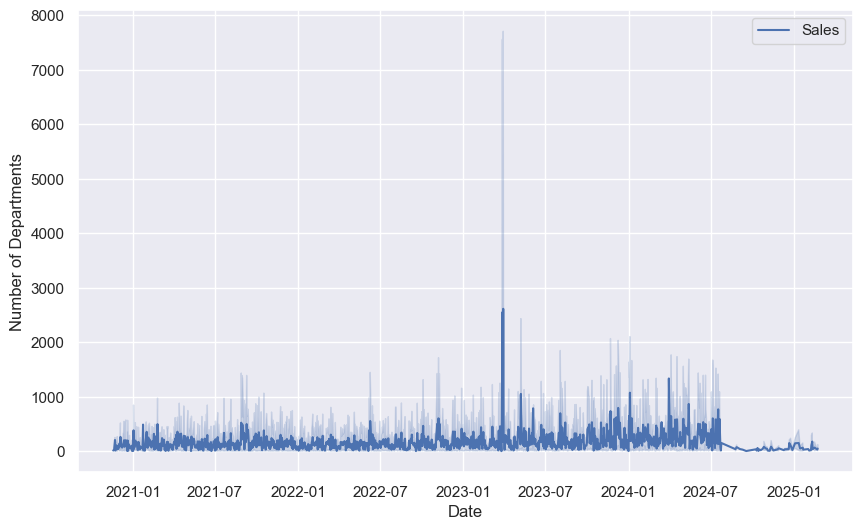

In [73]:
sns.lineplot(dept_forecast)
plt.ylabel("Number of Departments")

In [ ]:
# df_food2 = df_food1.drop("Scan_Sales", axis=1)
# df_food2

In [ ]:
#Excluding General Food to observe the sales
# df_food3 = df_food1[df_food1['Department'] != 'General Food']
# df_food3

In [ ]:
# df_foodfinal = df_food3.drop("Unnamed: 10", axis=1)
# # df_foodfinal

In [ ]:
#The get_dummies function in pandas is used for one-hot encoding, converting categorical variables into dummy or indicator variables.
#It transforms a column with distinct values into multiple binary columns, where each column represents a unique value from the original column. 
#For each row, it places a 1 in the column corresponding to the original value and 0 in the others. 
# This is useful for preparing categorical data for machine learning models, which typically require numerical input.

In [74]:
df_food2 = df_food1.join(pd.get_dummies(df['Department']))
pd.set_option("display.max_columns", None)
df_food2

,Date,Department,Items,Scan_Sales,Calling Card,Cleaning,Cleaning&body,Clothes,Condiments,Dairy,Drinks,Frozen,General Food,Grocery Non-Taxable,Household,Hygiene Feminine,Meat/Fish,Misc.,Pasta/Rice,Pinless Recharge,Service Fees,Snacks,Tobacco,Vitamins/Medicine
0,2020-11-18,General Food,2,5.00,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
1,2020-11-18,Misc.,1,15.00,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
2,2020-11-20,General Food,6,19.50,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
3,2020-11-20,Misc.,1,15.00,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
4,2020-11-22,General Food,35,253.00,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
5,2020-11-22,Meat/Fish,12,160.00,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
6,2020-11-23,General Food,4,20.00,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
7,2020-11-23,Snacks,8,8.00,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False
8,2020-11-24,General Food,34,223.00,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
9,2020-11-24,Meat/Fish,9,110.00,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False


In [75]:
df_food2 = df_food2.map(lambda x: 1 if x is True else 0 if x is False else x)
df_food2

,Date,Department,Items,Scan_Sales,Calling Card,Cleaning,Cleaning&body,Clothes,Condiments,Dairy,Drinks,Frozen,General Food,Grocery Non-Taxable,Household,Hygiene Feminine,Meat/Fish,Misc.,Pasta/Rice,Pinless Recharge,Service Fees,Snacks,Tobacco,Vitamins/Medicine
0,2020-11-18,General Food,2,5.00,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,2020-11-18,Misc.,1,15.00,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,2020-11-20,General Food,6,19.50,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,2020-11-20,Misc.,1,15.00,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,2020-11-22,General Food,35,253.00,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
5,2020-11-22,Meat/Fish,12,160.00,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
6,2020-11-23,General Food,4,20.00,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
7,2020-11-23,Snacks,8,8.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
8,2020-11-24,General Food,34,223.00,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
9,2020-11-24,Meat/Fish,9,110.00,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


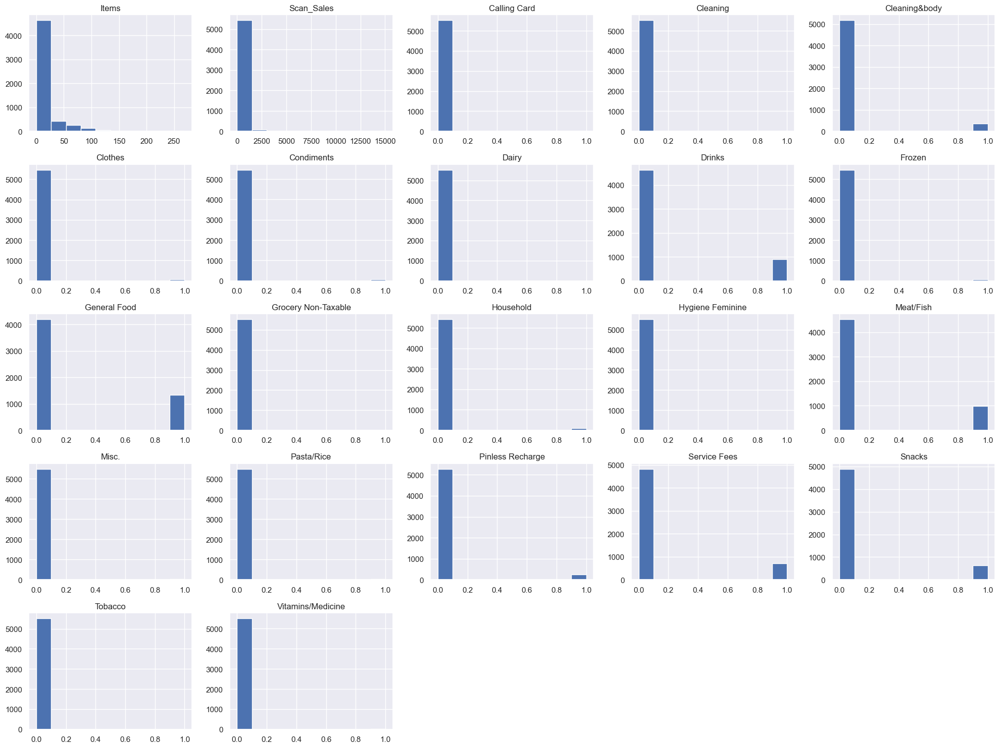

In [76]:
df_food2.hist(figsize=(20, 15))
plt.tight_layout()
plt.show()

## Which Department had the greater number of scan sales
## Which Department had the least number of scan sales

In [77]:
sum_data = df_food2.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data = sum_data.sort_values('Scan_Sales', ascending=False)
sum_data

,Department,Scan_Sales
8,General Food,809501.22
6,Drinks,66419.86
12,Meat/Fish,63899.56
2,Cleaning&body,7243.95
3,Clothes,5066.02
17,Snacks,2811.32
7,Frozen,2026.86
10,Household,2006.48
14,Pasta/Rice,420.10
4,Condiments,410.00


/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1300798837.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_data, palette='viridis')  # Added a color palette


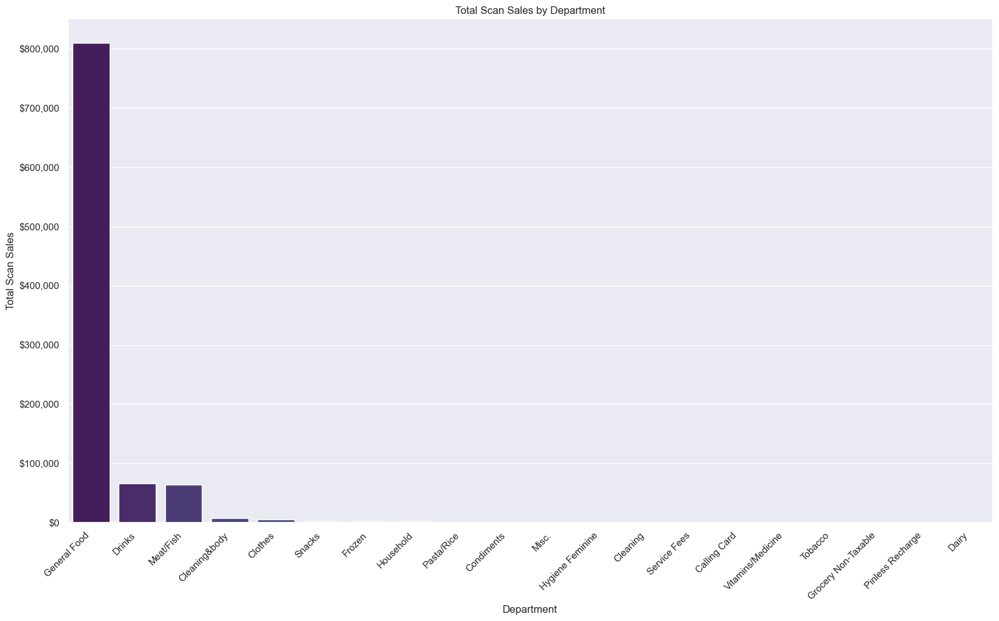

In [78]:

# df_food2 = pd.read_csv('deptsales_by_day.csv')



# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_data = df_food2.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data = sum_data.sort_values('Scan_Sales', ascending=False)


plt.figure(figsize=(16, 10))
sns.barplot(x='Department', y='Scan_Sales', data=sum_data, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Scan Sales by Department")
plt.xlabel("Department")
plt.ylabel("Total Scan Sales")  #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()

In [79]:
df_food2 = pd.read_csv('deptsales_by_day.csv')


# # # Check for missing sales data
# # if df_food2['Sales'].isnull().any():
# #     print("Warning: Missing sales data found. Consider handling NaN values.")

# sum_data = df_food2.groupby('Department')['Avg_Sale'].sum().reset_index()
# sum_data = sum_data.sort_values('Avg_Sale', ascending=False)


# plt.figure(figsize=(16, 10))
# sns.barplot(x='Department', y='Avg_Sale', data=sum_data, palette='viridis')  # Added a color palette
# plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
# plt.title("Total Average Sales by Department")
# plt.xlabel("Department")
# plt.ylabel("Total Avg_Sales")  #Added y axis label
# plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

# plt.tight_layout() #adjusts plot parameters for a tight layout

# plt.show()

In [80]:
# df_food3 = df_food2[df_food2['Department'] != 'General Food']
# df_food3


In [81]:
df_food1

,Date,Department,Items,Scan_Sales
0,2020-11-18,General Food,2,5.00
1,2020-11-18,Misc.,1,15.00
2,2020-11-20,General Food,6,19.50
3,2020-11-20,Misc.,1,15.00
4,2020-11-22,General Food,35,253.00
5,2020-11-22,Meat/Fish,12,160.00
6,2020-11-23,General Food,4,20.00
7,2020-11-23,Snacks,8,8.00
8,2020-11-24,General Food,34,223.00
9,2020-11-24,Meat/Fish,9,110.00


In [82]:

# Dropping any features in tems that are 0
df_food1 = df_food1[df_food1['Items'] != 0]
df_food1

,Date,Department,Items,Scan_Sales
0,2020-11-18,General Food,2,5.00
1,2020-11-18,Misc.,1,15.00
2,2020-11-20,General Food,6,19.50
3,2020-11-20,Misc.,1,15.00
4,2020-11-22,General Food,35,253.00
5,2020-11-22,Meat/Fish,12,160.00
6,2020-11-23,General Food,4,20.00
7,2020-11-23,Snacks,8,8.00
8,2020-11-24,General Food,34,223.00
9,2020-11-24,Meat/Fish,9,110.00


In [83]:
sum_items = df_food1.groupby('Department')['Items'].sum().reset_index()
sum_items = sum_items.sort_values('Items', ascending=False)
sum_items

,Department,Items
8,General Food,61354
6,Drinks,4305
12,Meat/Fish,4100
17,Snacks,3439
2,Cleaning&body,800
15,Pinless Recharge,290
4,Condiments,245
10,Household,218
3,Clothes,169
7,Frozen,161


/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1424450376.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_items, palette='viridis')  # Added a color palette


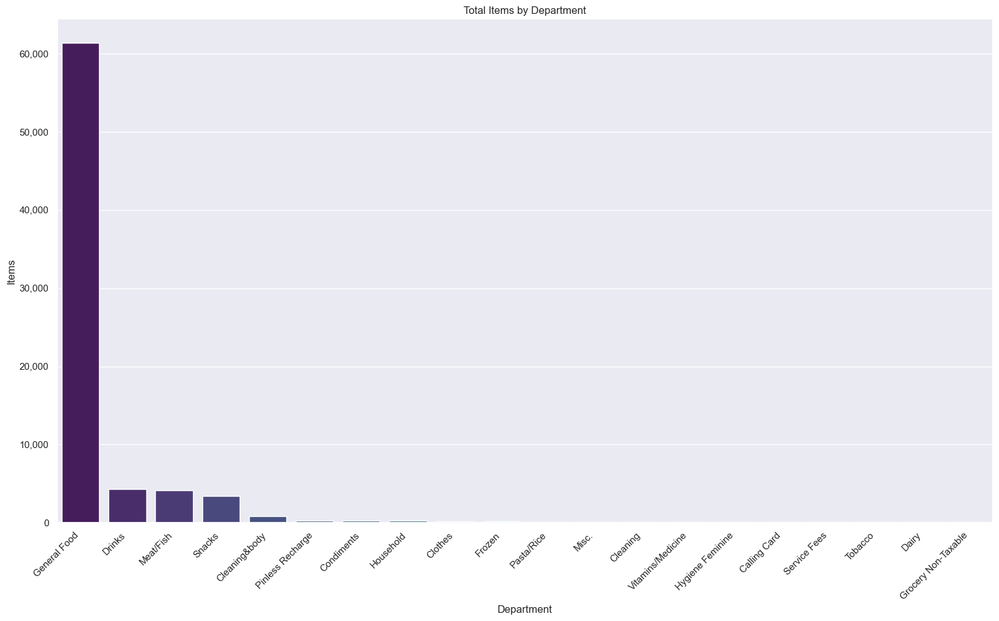

In [84]:
# df_food2 = pd.read_csv('deptsales_by_day.csv')


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_items = df_food2.groupby('Department')['Items'].sum().reset_index()
sum_items = sum_items.sort_values('Items', ascending=False)


plt.figure(figsize=(16, 10))
sns.barplot(x='Department', y='Items', data=sum_items, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department")
plt.xlabel("Department")
plt.ylabel("Items")  #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()

In [85]:
# # Group by 'Department' and sum 'Sales'

# sum_data = df_food3.groupby('Department')['Sales'].sum().reset_index()
# sum_data = sum_data.sort_values('Sales', ascending=False)
# df_food3 = pd.DataFrame()
# # Create bar plot

# plt.figure(figsize=(16, 10))
# sns.barplot(x='Department', y='Sales', data=sum_data, palette='viridis')  # Added a color palette
# plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
# plt.title("Total Sales by Department")
# plt.xlabel("Department")
# plt.ylabel("Total Sales")  #Added y axis label
# plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

# plt.tight_layout() #adjusts plot parameters for a tight layout

# plt.show()

In [86]:

# df_food2 = pd.DataFrame()

# # Plotting
# df['Department'].value_counts().plot(kind='bar')
# plt.xlabel('Department')
# plt.ylabel('Sales')
# plt.title('Overall Number of Sales in each Department')
# plt.show()

In [87]:
# df_food2 = pd.DataFrame()

# #plotting
# df["Department"].value_counts().plot(kind='bar')
# plt.xlabel('Department')
# plt.ylabel('Avg_Sale')
# plt.title('Overall Number of Avg_Sales in each Department')
# plt.show()

In [88]:



# df["Department"].value_counts().plot(kind='bar')
# plt.xlabel('Department')
# plt.ylabel('Items')
# plt.title('Overall Number of Items in each Department')
# plt.show()

In [89]:
# df["Department"].value_counts().plot(kind='bar')
# plt.xlabel('Department')
# plt.ylabel('Avg_Items')
# plt.title('Overall Number of avg_Items in each Department')
# plt.show()

#Data Trends


### Winter of 2020/2021

In [104]:
df_winter20_21 = pd.read_csv("beni_winter20_21.csv", encoding = 'utf-8')
df_spring2021 = pd.read_csv("beni_spring21.csv", encoding = 'utf-8')
df_summer2021 = pd.read_csv("beni_summer21.csv", encoding = 'utf-8')
df_fall2021 = pd.read_csv("beni_fall21.csv", encoding = 'utf-8')


df_winter21_22 = pd.read_csv("beni_winter21_22.csv", encoding = 'utf-8')
df_spring2022 = pd.read_csv("beni_spring22.csv", encoding = 'utf-8')
df_summer2022 = pd.read_csv("beni_summer22.csv", encoding = 'utf-8')
df_fall2022 = pd.read_csv("beni_fall22.csv", encoding = 'utf-8')


df_winter22_23 = pd.read_csv("beni_winter22_23.csv", encoding = 'utf-8')
df_spring2023 = pd.read_csv("beni_spring23.csv", encoding = 'utf-8')
df_summer2023 = pd.read_csv("beni_summer23.csv", encoding = 'utf-8')
df_fall2023 = pd.read_csv("beni_fall23.csv", encoding = 'utf-8')


df_winter23_24 = pd.read_csv("beni_winter23_24.csv", encoding = 'utf-8')
df_spring2024 = pd.read_csv("beni_spring24.csv", encoding = 'utf-8')
df_summer2024 = pd.read_csv("beni_summer24.csv", encoding = 'utf-8')
df_fall2024 = pd.read_csv("beni_fall24.csv", encoding = 'utf-8')
df_winter24_25 = pd.read_csv("beni_winter24_25.csv", encoding = 'utf-8')




vertical_concat = pd.concat([df_winter20_21, df_spring2021, df_summer2021, df_fall2021, df_winter21_22, df_spring2022, df_summer2022, df_fall2022, df_winter22_23, df_spring2023, df_summer2023, df_fall2023, df_winter23_24, df_spring2024, df_summer2024, df_fall2024, df_winter24_25], axis=0, ignore_index=True)

print("Here: ")
vertical_concat[0:10]

Here: 


,Date,Department,Baskets,Items,Avg_Items,Sales,Avg_Sale,Scan_Rate,Scan_Sales
0,11/18/20,General Food,2.0,2.0,1.0,15.0,7.50,50.0,5.0
1,11/18/20,Misc.,1.0,1.0,1.0,15.0,15.00,100.0,15.0
2,11/20/20,General Food,4.0,6.0,1.5,19.5,4.87,100.0,19.5
3,11/20/20,Misc.,1.0,1.0,1.0,15.0,15.00,100.0,15.0
4,11/22/20,General Food,6.0,35.0,5.8,253.0,42.16,100.0,253.0
5,11/22/20,Meat/Fish,3.0,12.0,4.0,160.0,53.33,100.0,160.0
6,11/23/20,General Food,1.0,4.0,4.0,20.0,20.00,100.0,20.0
7,11/23/20,Snacks,1.0,8.0,8.0,8.0,8.00,100.0,8.0
8,11/24/20,General Food,5.0,34.0,6.8,223.0,44.60,100.0,223.0
9,11/24/20,Meat/Fish,3.0,9.0,3.0,110.0,36.66,100.0,110.0


In [91]:
df_winter20_21 = df_winter20_21.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_spring2021 = df_spring2021.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_summer2021 = df_summer2021.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_fall2021 = df_fall2021.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])

df_winter21_22 = df_winter21_22.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_spring2022 = df_spring2022.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_summer2022 = df_summer2022.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_fall2022 = df_fall2022.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])

df_winter22_23 = df_winter22_23.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_spring2023 = df_spring2023.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_summer2023v= df_summer2023.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_fall2023 = df_fall2023.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])

df_winter23_24 = df_winter23_24.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_spring2024 = df_spring2024.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_summer2024 = df_summer2024.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_fall2024 = df_fall2024.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])
df_winter24_25 = df_winter24_25.drop(columns = ['Baskets', 'Sales', 'Scan_Rate', 'Avg_Sale', 'Avg_Items'])



vertical_concat = pd.concat([df_winter20_21, df_spring2021, df_summer2021, df_fall2021, df_winter21_22, df_spring2022, df_summer2022, df_fall2022, df_winter22_23, df_spring2023, df_summer2023, df_fall2023, df_winter23_24, df_spring2024, df_summer2024, df_fall2024, df_winter24_25], axis=0, ignore_index=True)



vertical_concat

,Date,Department,Items,Scan_Sales,Baskets,Avg_Items,Sales,Avg_Sale,Scan_Rate
0,11/18/20,General Food,2.0,5.00,NaN,NaN,NaN,NaN,NaN
1,11/18/20,Misc.,1.0,15.00,NaN,NaN,NaN,NaN,NaN
2,11/20/20,General Food,6.0,19.50,NaN,NaN,NaN,NaN,NaN
3,11/20/20,Misc.,1.0,15.00,NaN,NaN,NaN,NaN,NaN
4,11/22/20,General Food,35.0,253.00,NaN,NaN,NaN,NaN,NaN
5,11/22/20,Meat/Fish,12.0,160.00,NaN,NaN,NaN,NaN,NaN
6,11/23/20,General Food,4.0,20.00,NaN,NaN,NaN,NaN,NaN
7,11/23/20,Snacks,8.0,8.00,NaN,NaN,NaN,NaN,NaN
8,11/24/20,General Food,34.0,223.00,NaN,NaN,NaN,NaN,NaN
9,11/24/20,Meat/Fish,9.0,110.00,NaN,NaN,NaN,NaN,NaN


In [92]:
df_winter20_21.value_counts('Department')

Department
General Food     94
Meat/Fish        58
Snacks           34
Drinks           33
Cleaning&body     6
Misc.             3
Name: count, dtype: int64

In [93]:
sum_data20_21 = df_winter20_21.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data20_21 = sum_data20_21.sort_values('Scan_Sales', ascending=False)


sum_spring2021 = df_spring2021.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_spring2021 = sum_spring2021.sort_values('Scan_Sales', ascending=False)


sum_summer2021 = df_summer2021.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_summer2021 = sum_summer2021.sort_values('Scan_Sales', ascending=False)


sum_fall2021 = df_summer2021.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_summer2021 = sum_summer2021.sort_values('Scan_Sales', ascending=False)


vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021, sum_summer2021], axis=0, ignore_index=True)




vertical_concat_sum

,Department,Scan_Sales
0,General Food,23871.51
1,Meat/Fish,2516.00
2,Drinks,850.25
3,Snacks,92.04
4,Cleaning&body,63.00
5,Misc.,45.00
6,General Food,32490.65
7,Meat/Fish,3599.96
8,Drinks,1498.80
9,Cleaning&body,316.00


/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_data20_21, palette='viridis')  # Added a color palette


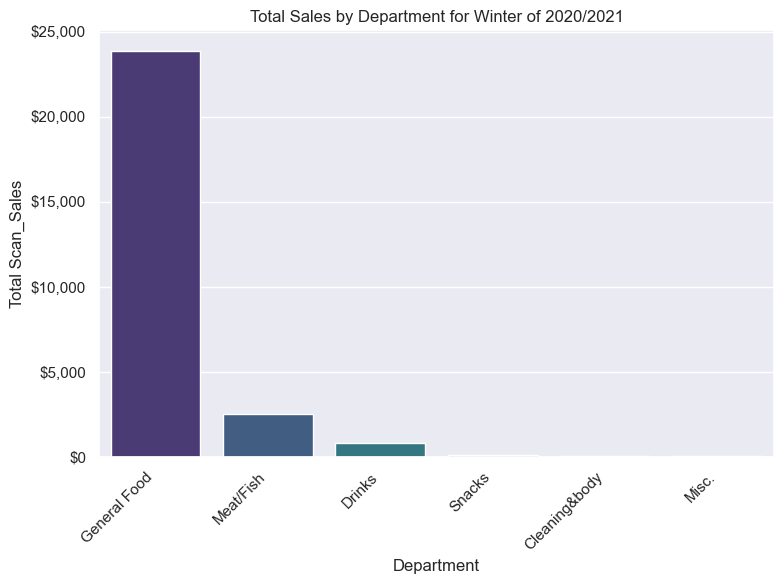

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:32: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2021, palette='viridis')  # Added a color palette


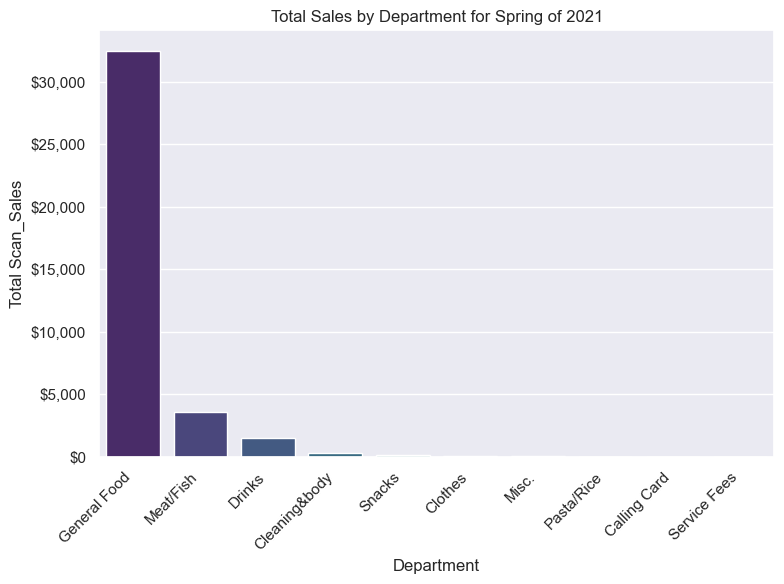

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2021, palette='viridis')  # Added a color palette


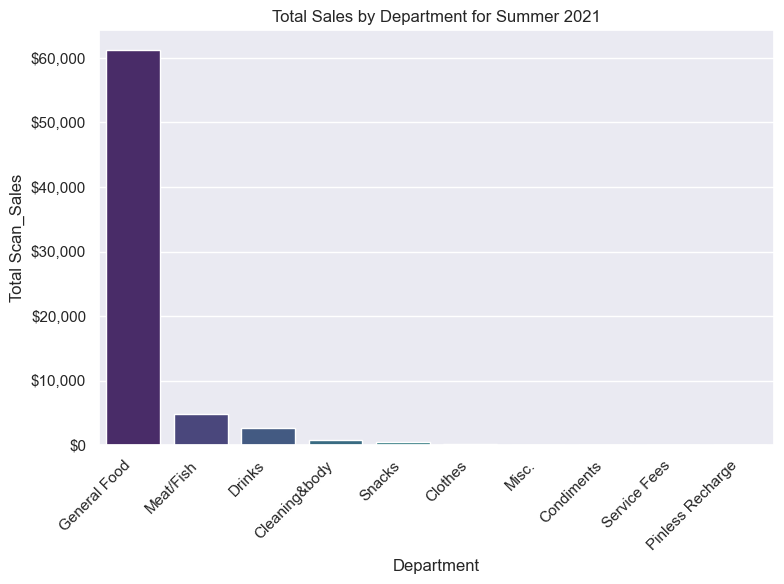

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2021, palette='viridis')  # Added a color palette


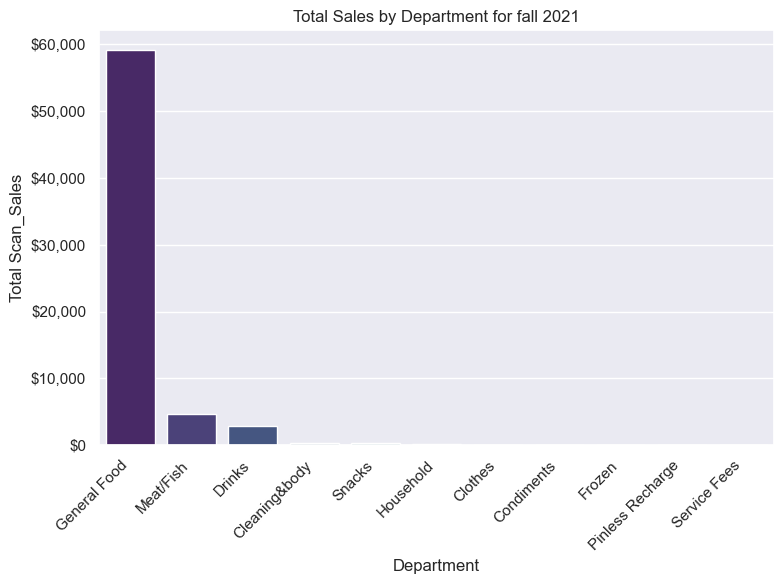

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:104: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_data21_22, palette='viridis')  # Added a color palette


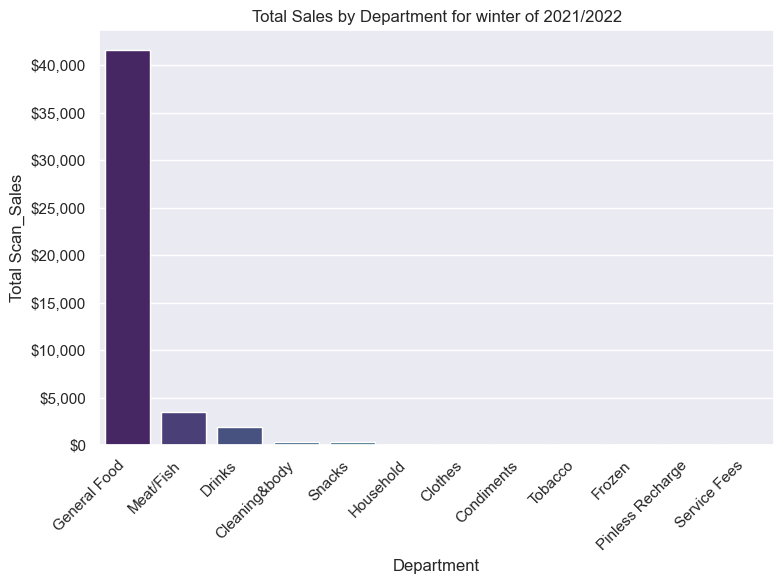

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:122: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2022, palette='viridis')  # Added a color palette


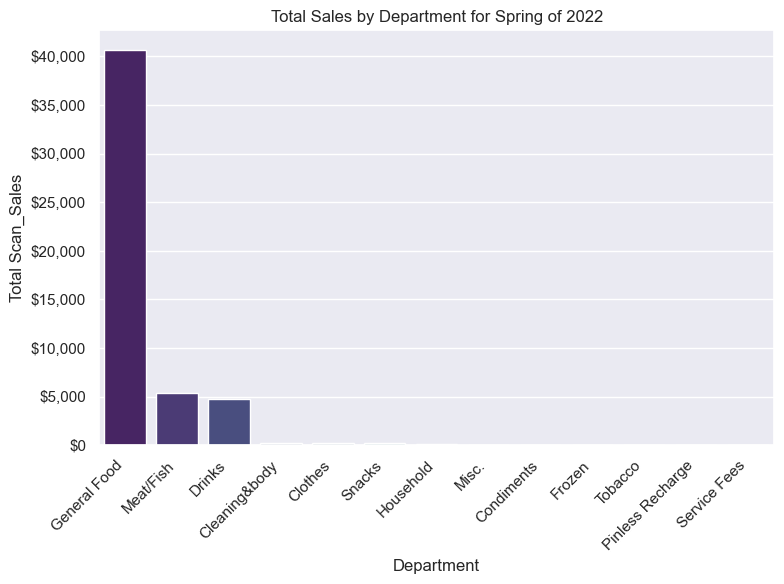

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:147: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2022, palette='viridis')  # Added a color palette


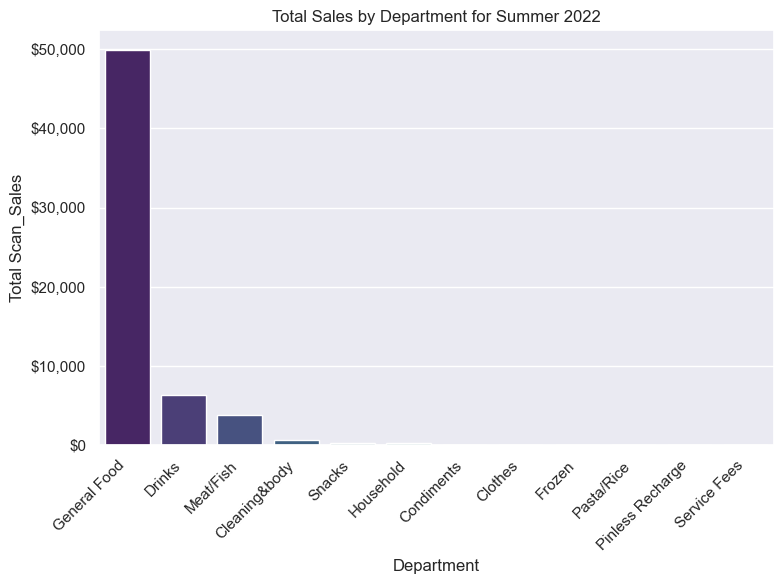

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:169: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2022, palette='viridis')  # Added a color palette


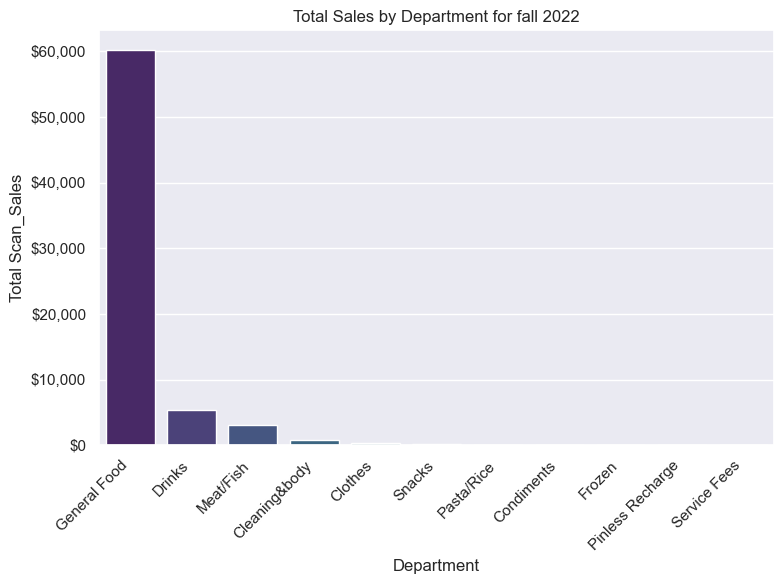

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:196: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_data22_23, palette='viridis')  # Added a color palette


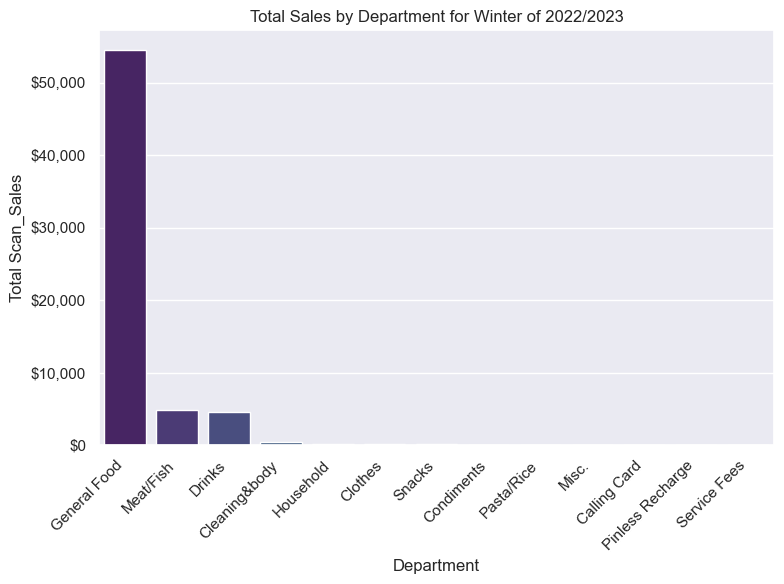

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:214: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2023, palette='viridis')  # Added a color palette


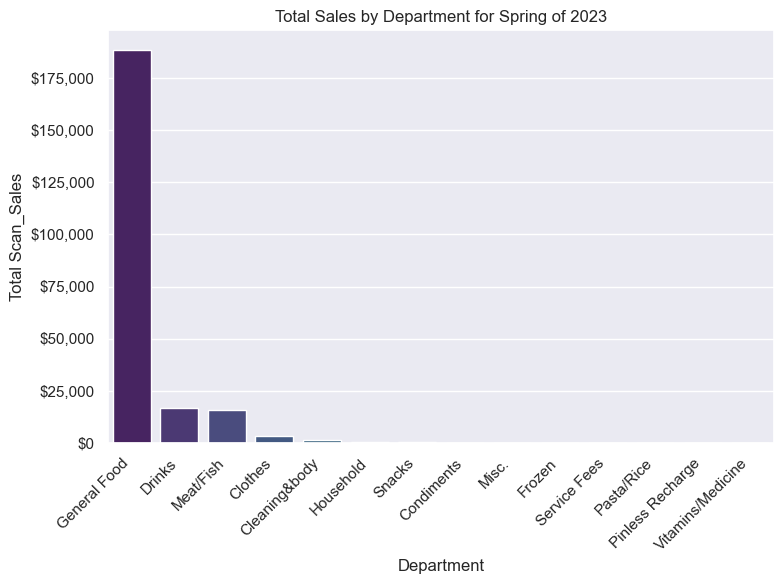

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:239: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2023, palette='viridis')  # Added a color palette


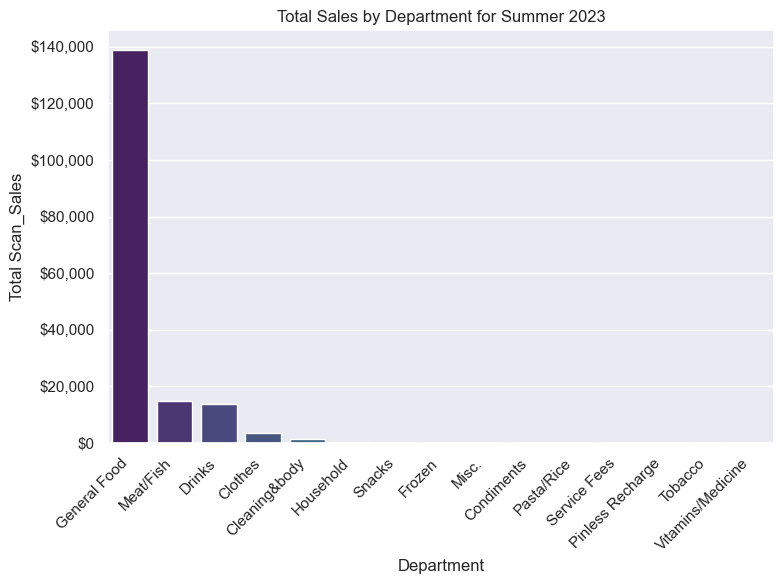

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:261: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2023, palette='viridis')  # Added a color palette


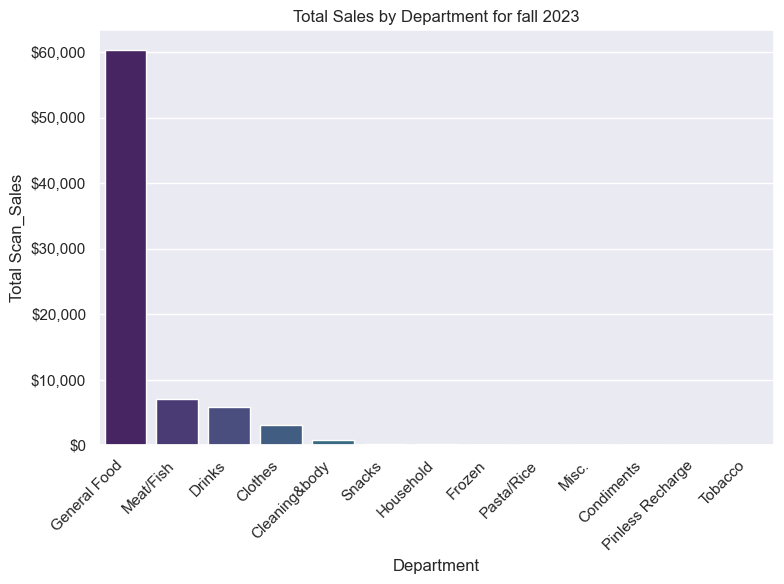

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:289: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_data23_24, palette='viridis')  # Added a color palette


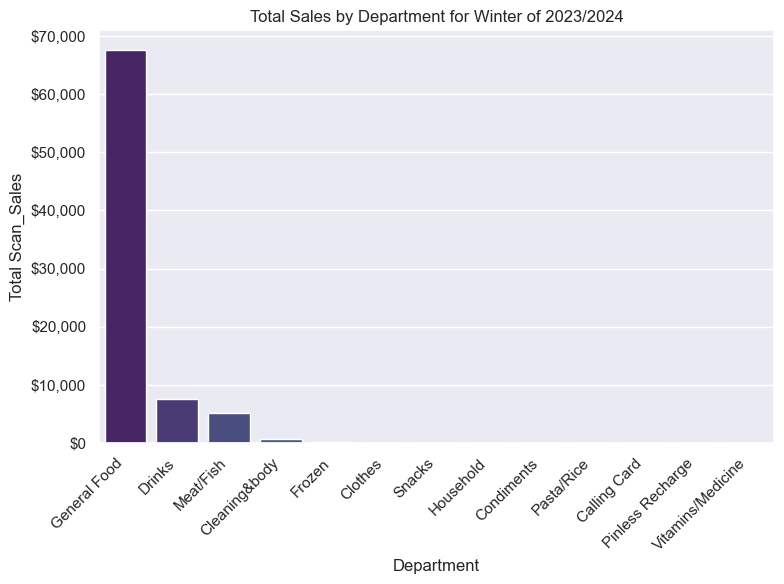

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:307: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2024, palette='viridis')  # Added a color palette


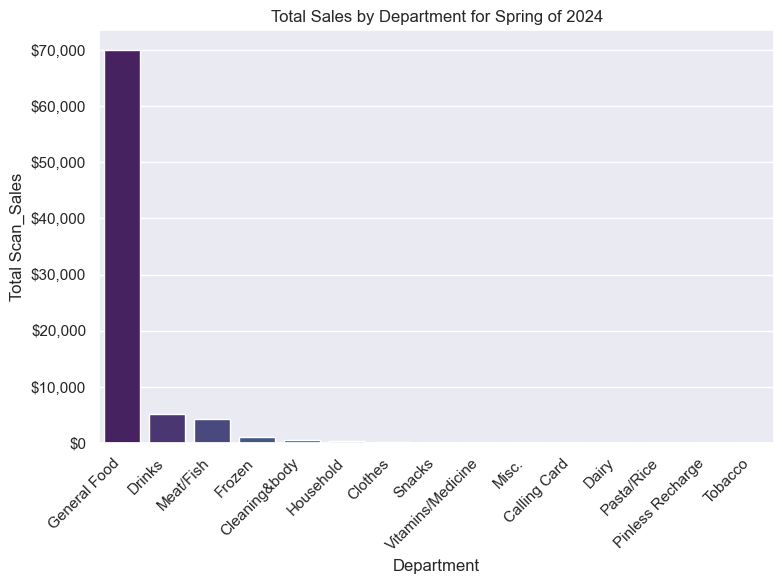

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:332: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2024, palette='viridis')  # Added a color palette


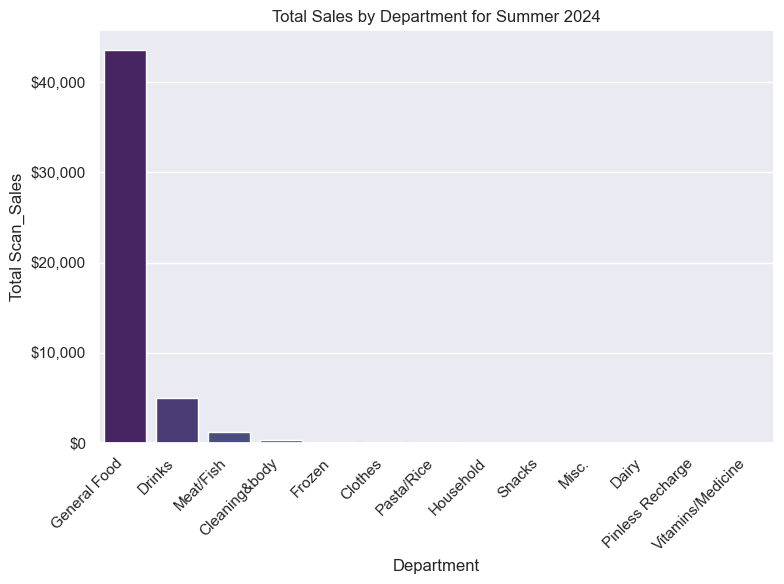

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:354: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2024, palette='viridis')  # Added a color palette


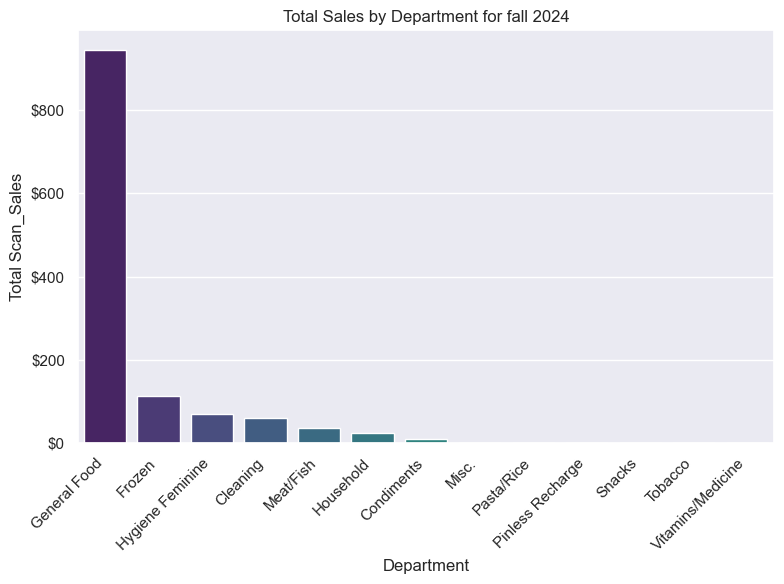

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/2671179047.py:376: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Scan_Sales', data=sum_data24_25, palette='viridis')  # Added a color palette


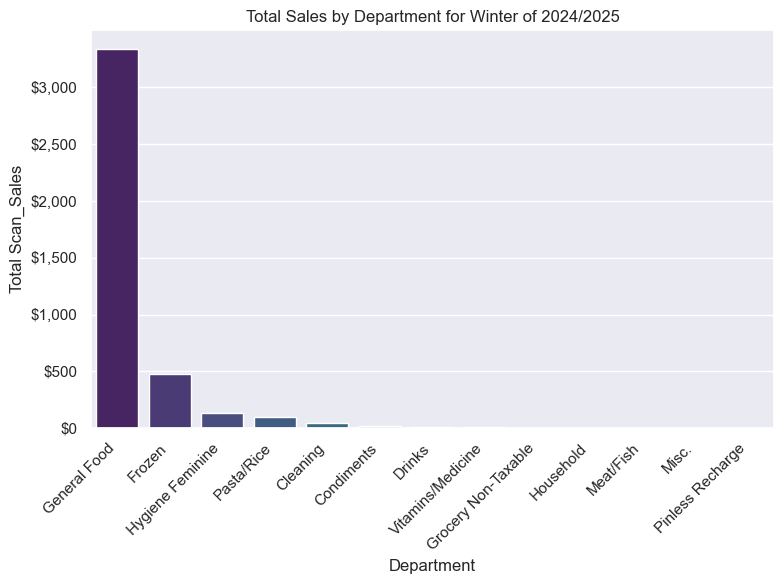

In [94]:
# Check for missing sales data
# if df_food2['Sales'].isnull().any():
# print("Warning: Missing sales data found. Consider handling NaN values.")

sum_data20_21 = df_winter20_21.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data20_21 = sum_data20_21.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_data20_21, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Winter of 2020/2021")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2021 = df_spring2021.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_spring2021 = sum_spring2021.sort_values('Scan_Sales', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2021, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Spring of 2021")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2021 = df_summer2021.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_summer2021 = sum_summer2021.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2021, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Summer 2021")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2021 = df_fall2021.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_fall2021 = sum_fall2021.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2021, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for fall 2021")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


#New data



sum_data21_22 = df_winter21_22.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data21_22 = sum_data21_22.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_data21_22, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for winter of 2021/2022")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2022 = df_spring2022.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_spring2022 = sum_spring2022.sort_values('Scan_Sales', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2022, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Spring of 2022")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2022 = df_summer2022.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_summer2022 = sum_summer2022.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2022, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Summer 2022")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2022 = df_fall2022.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_fall2022 = sum_fall2022.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2022, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for fall 2022")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()




#new data



sum_data22_23 = df_winter22_23.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data22_23 = sum_data22_23.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_data22_23, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Winter of 2022/2023")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2023 = df_spring2023.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_spring2023 = sum_spring2023.sort_values('Scan_Sales', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2023, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Spring of 2023")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2023 = df_summer2023.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_summer2023 = sum_summer2023.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2023, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Summer 2023")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2023 = df_fall2023.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_fall2023 = sum_fall2023.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2023, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for fall 2023")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()







#new data

sum_data23_24 = df_winter23_24.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data23_24 = sum_data23_24.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_data23_24, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Winter of 2023/2024")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2024 = df_spring2024.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_spring2024 = sum_spring2024.sort_values('Scan_Sales', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_spring2024, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Spring of 2024")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2024 = df_summer2024.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_summer2024 = sum_summer2024.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_summer2024, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Summer 2024")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2024 = df_fall2024.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_fall2024 = sum_fall2024.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_fall2024, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for fall 2024")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_data24_25 = df_winter24_25.groupby('Department')['Scan_Sales'].sum().reset_index()
sum_data24_25 = sum_data24_25.sort_values('Scan_Sales', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Scan_Sales', data=sum_data24_25, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Sales by Department for Winter of 2024/2025")
plt.xlabel("Department")
plt.ylabel("Total Scan_Sales") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('${x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()







/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_data20_21, palette='viridis')  # Added a color palette


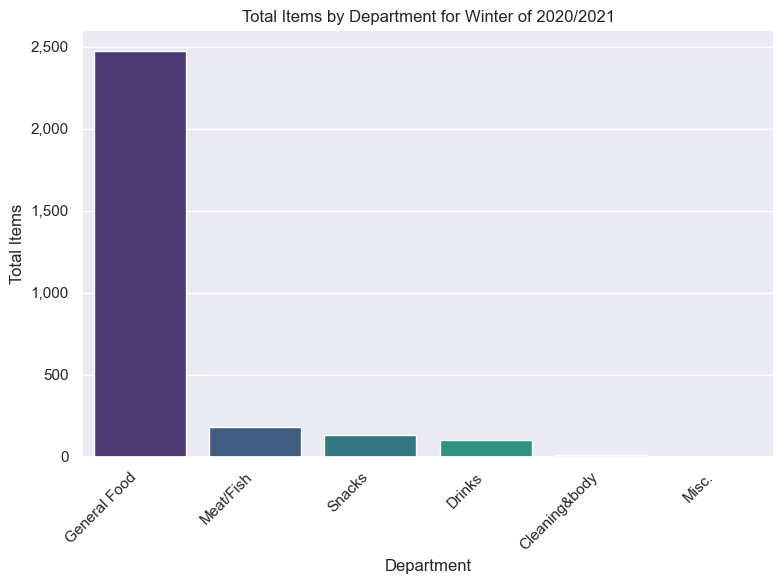

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_spring2021, palette='viridis')  # Added a color palette


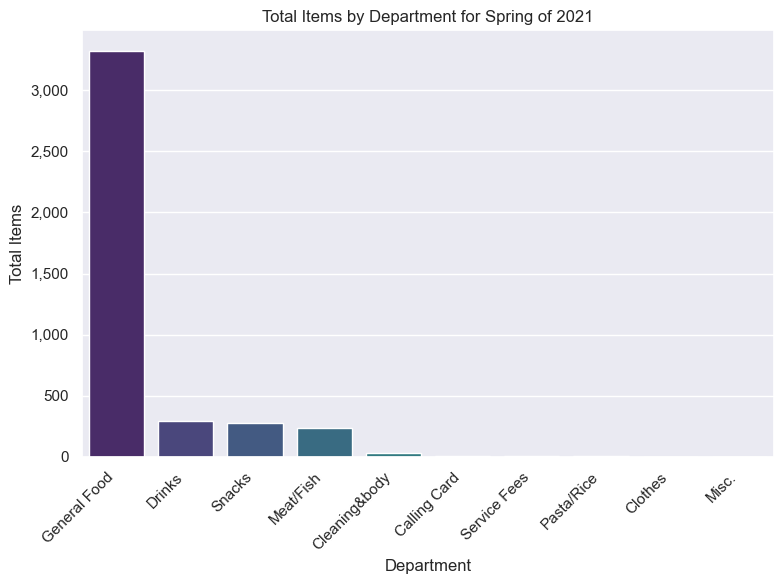

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:53: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_summer2021, palette='viridis')  # Added a color palette


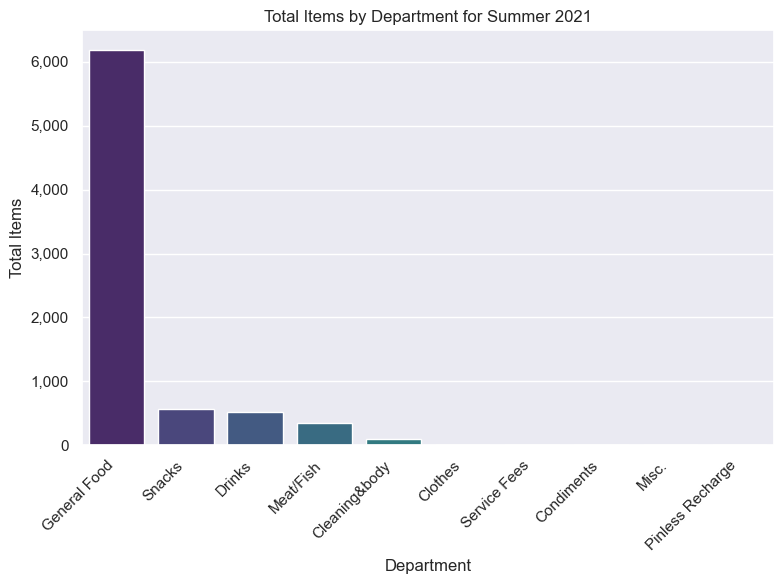

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_fall2021, palette='viridis')  # Added a color palette


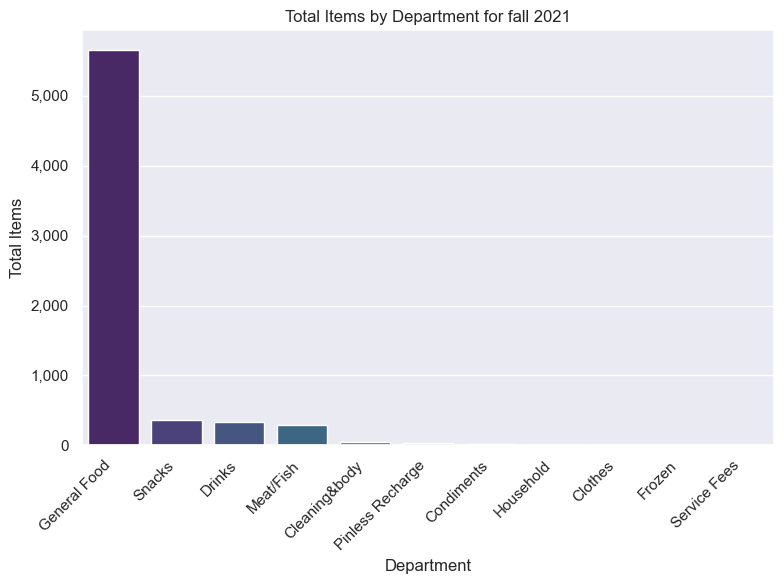

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:100: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_data21_22, palette='viridis')  # Added a color palette


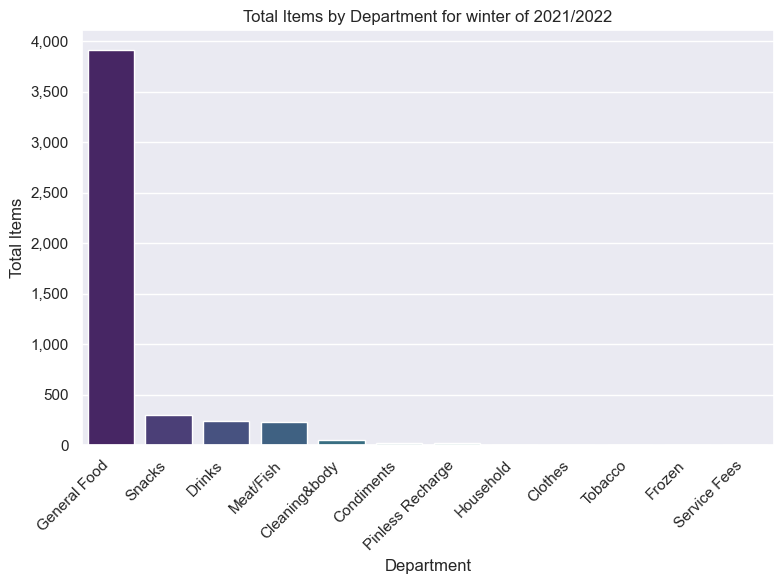

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:118: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_spring2022, palette='viridis')  # Added a color palette


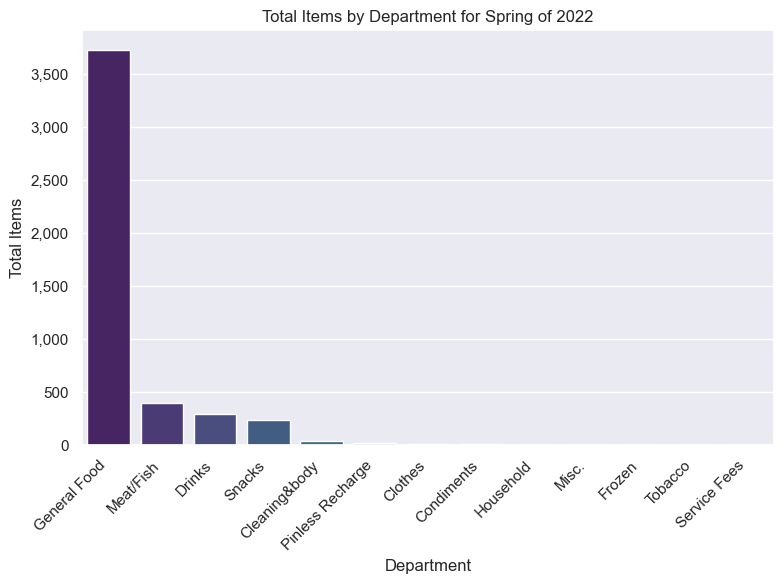

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:143: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_summer2022, palette='viridis')  # Added a color palette


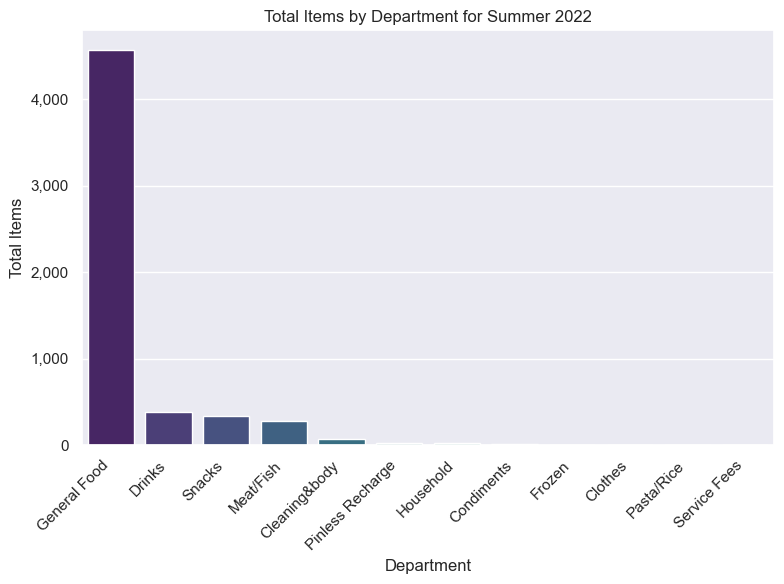

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:165: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_fall2022, palette='viridis')  # Added a color palette


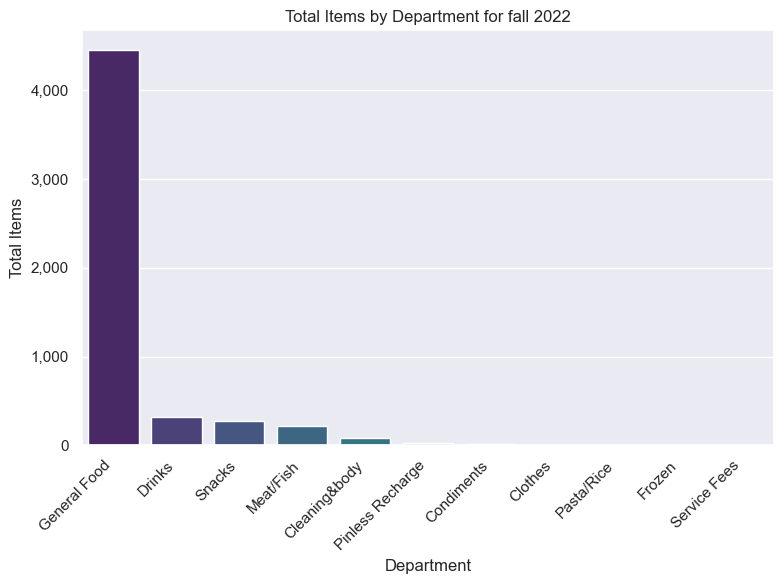

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:192: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_data22_23, palette='viridis')  # Added a color palette


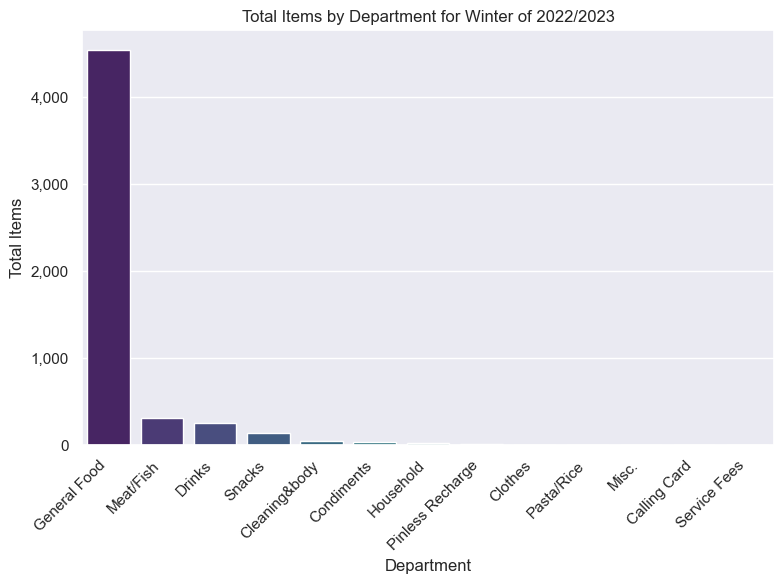

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:210: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_spring2023, palette='viridis')  # Added a color palette


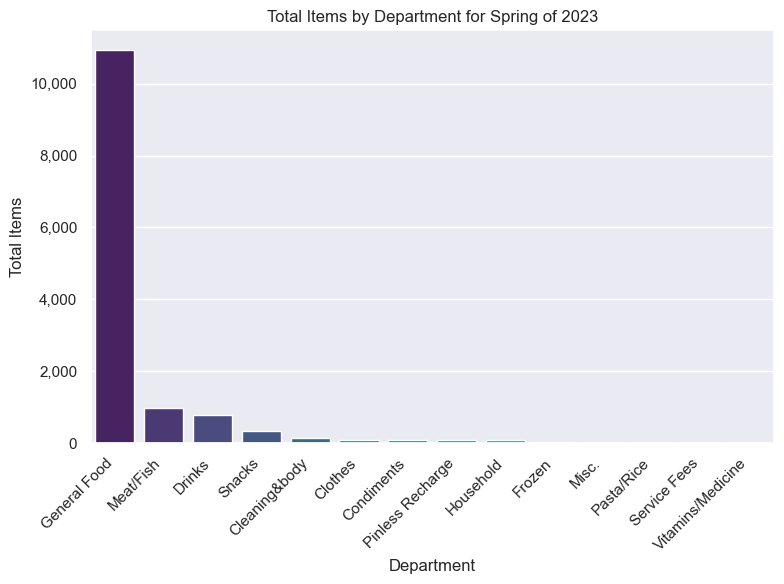

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:235: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_summer2023, palette='viridis')  # Added a color palette


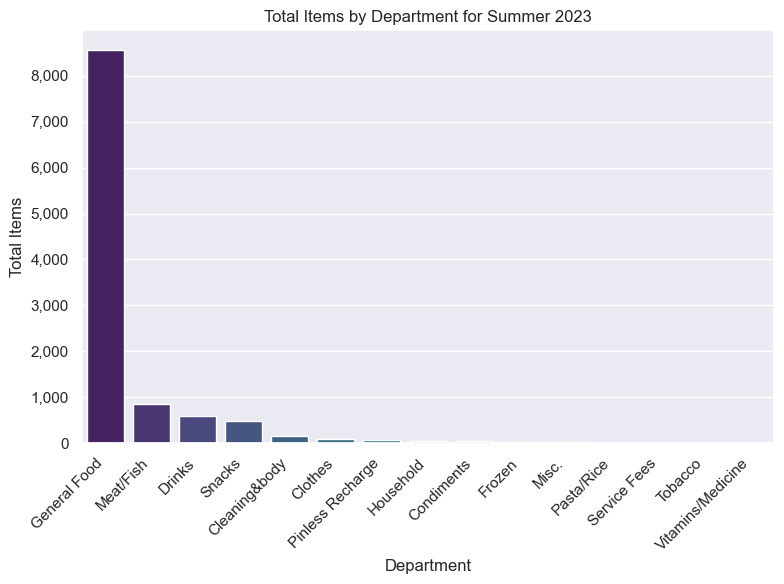

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:257: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_fall2023, palette='viridis')  # Added a color palette


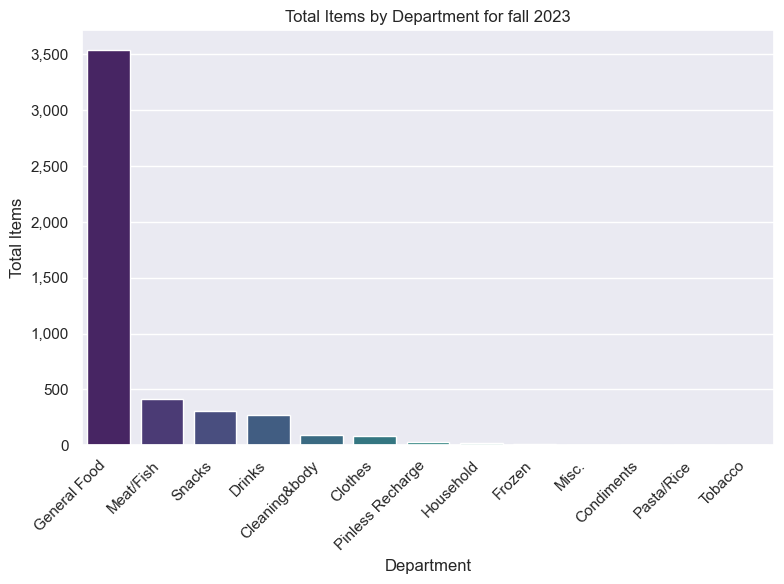

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:285: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_data23_24, palette='viridis')  # Added a color palette


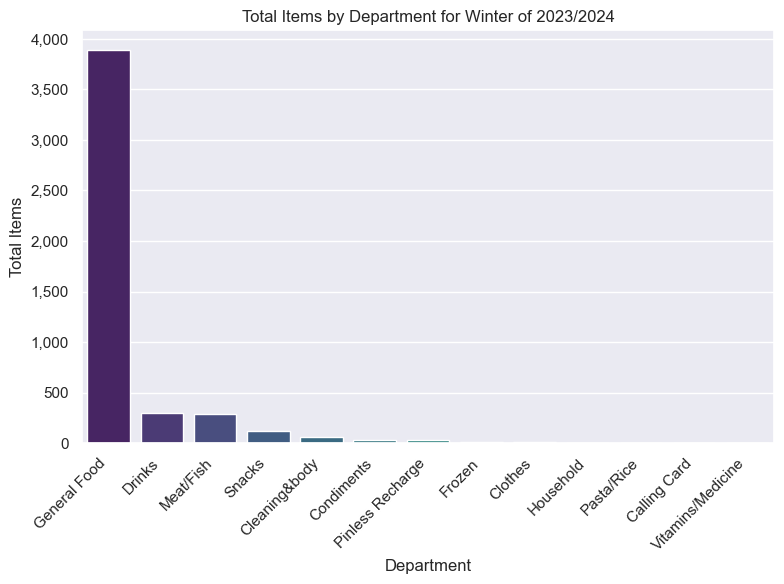

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:303: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_spring2024, palette='viridis')  # Added a color palette


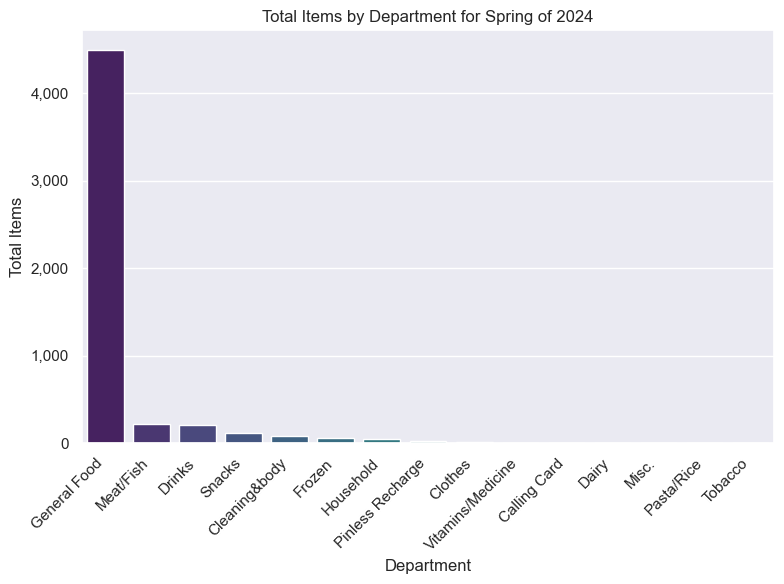

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:328: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_summer2024, palette='viridis')  # Added a color palette


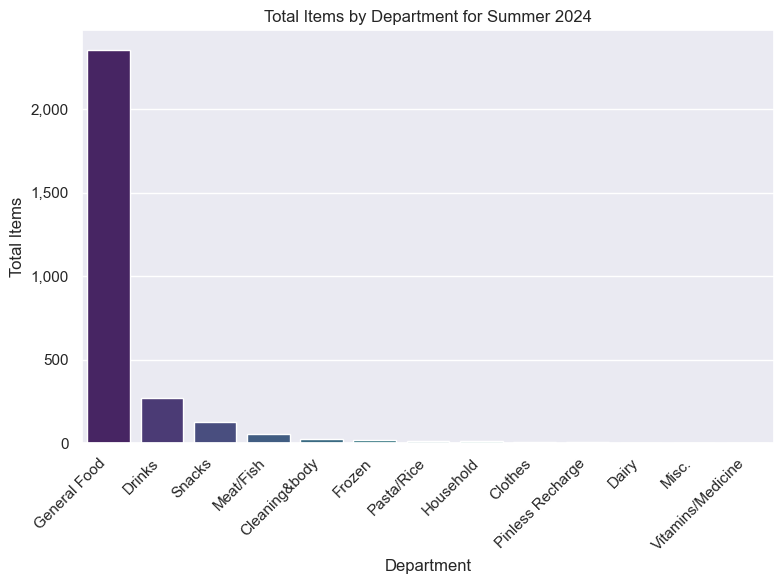

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:350: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_fall2024, palette='viridis')  # Added a color palette


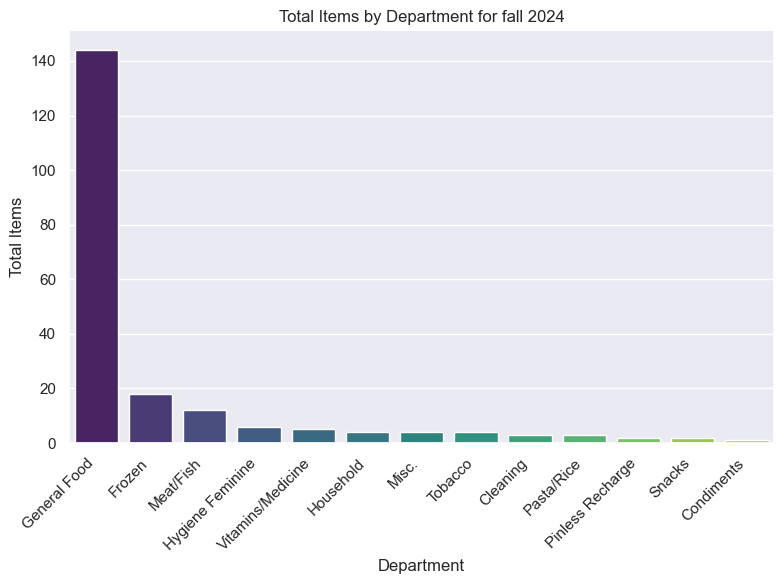

/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1329729691.py:372: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_data24_25, palette='viridis')  # Added a color palette


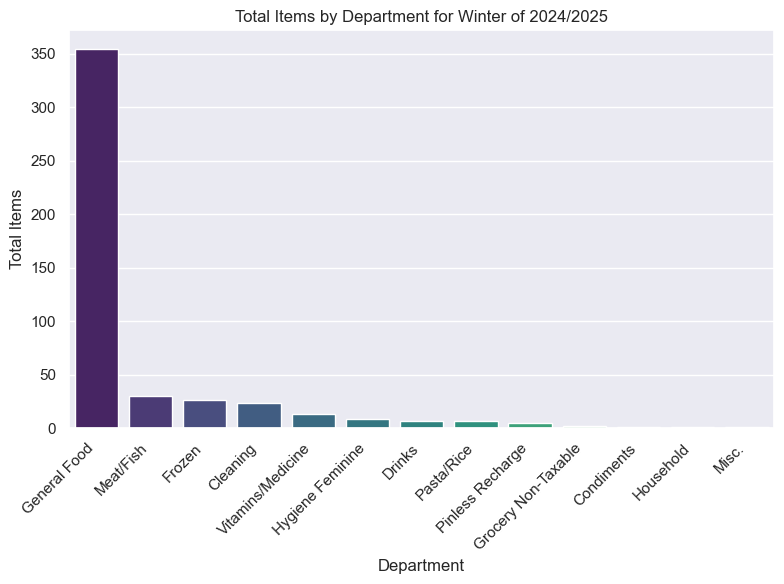

In [95]:
sum_data20_21 = df_winter20_21.groupby('Department')['Items'].sum().reset_index()
sum_data20_21 = sum_data20_21.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_data20_21, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Winter of 2020/2021")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2021 = df_spring2021.groupby('Department')['Items'].sum().reset_index()
sum_spring2021 = sum_spring2021.sort_values('Items', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_spring2021, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Spring of 2021")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2021 = df_summer2021.groupby('Department')['Items'].sum().reset_index()
sum_summer2021 = sum_summer2021.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_summer2021, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Summer 2021")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2021 = df_fall2021.groupby('Department')['Items'].sum().reset_index()
sum_fall2021 = sum_fall2021.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_fall2021, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for fall 2021")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


#New data



sum_data21_22 = df_winter21_22.groupby('Department')['Items'].sum().reset_index()
sum_data21_22 = sum_data21_22.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_data21_22, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for winter of 2021/2022")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2022 = df_spring2022.groupby('Department')['Items'].sum().reset_index()
sum_spring2022 = sum_spring2022.sort_values('Items', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_spring2022, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Spring of 2022")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2022 = df_summer2022.groupby('Department')['Items'].sum().reset_index()
sum_summer2022 = sum_summer2022.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_summer2022, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Summer 2022")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2022 = df_fall2022.groupby('Department')['Items'].sum().reset_index()
sum_fall2022 = sum_fall2022.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_fall2022, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for fall 2022")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()




#new data



sum_data22_23 = df_winter22_23.groupby('Department')['Items'].sum().reset_index()
sum_data22_23 = sum_data22_23.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_data22_23, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Winter of 2022/2023")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2023 = df_spring2023.groupby('Department')['Items'].sum().reset_index()
sum_spring2023 = sum_spring2023.sort_values('Items', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_spring2023, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Spring of 2023")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2023 = df_summer2023.groupby('Department')['Items'].sum().reset_index()
sum_summer2023 = sum_summer2023.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_summer2023, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Summer 2023")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2023 = df_fall2023.groupby('Department')['Items'].sum().reset_index()
sum_fall2023 = sum_fall2023.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_fall2023, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for fall 2023")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()







#new data

sum_data23_24 = df_winter23_24.groupby('Department')['Items'].sum().reset_index()
sum_data23_24 = sum_data23_24.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_data23_24, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Winter of 2023/2024")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_spring2024 = df_spring2024.groupby('Department')['Items'].sum().reset_index()
sum_spring2024 = sum_spring2024.sort_values('Items', ascending=False)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_spring2024, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Spring of 2024")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


# # Check for missing sales data
# if df_food2['Sales'].isnull().any():
#     print("Warning: Missing sales data found. Consider handling NaN values.")

sum_summer2024 = df_summer2024.groupby('Department')['Items'].sum().reset_index()
sum_summer2024 = sum_summer2024.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_summer2024, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Summer 2024")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_fall2024 = df_fall2024.groupby('Department')['Items'].sum().reset_index()
sum_fall2024 = sum_fall2024.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_fall2024, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for fall 2024")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()



sum_data24_25 = df_winter24_25.groupby('Department')['Items'].sum().reset_index()
sum_data24_25 = sum_data24_25.sort_values('Items', ascending=False)



# vertical_concat_sum = pd.concat([sum_data20_21, sum_spring2021], axis=0, ignore_index=True)


plt.figure(figsize=(8, 6))
sns.barplot(x='Department', y='Items', data=sum_data24_25, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Winter of 2024/2025")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()


In [96]:
df_winter20_21.value_counts('Items')


Items
1     51
2     28
3     21
5     13
4     10
7      9
6      8
9      6
8      5
10     5
15     4
16     4
26     4
12     4
40     3
52     3
19     3
36     3
25     3
11     2
61     2
45     2
42     2
39     2
27     2
14     2
21     2
20     2
24     1
51     1
76     1
68     1
64     1
63     1
17     1
58     1
56     1
53     1
18     1
49     1
50     1
34     1
47     1
46     1
41     1
13     1
22     1
38     1
23     1
35     1
80     1
Name: count, dtype: int64

In [97]:
sum_items20_21 = df_winter20_21.groupby('Department')['Items'].sum().reset_index()
sum_items20_21 = sum_items20_21.sort_values('Items', ascending = False)
sum_items20_21

,Department,Items
2,General Food,2475
3,Meat/Fish,181
5,Snacks,133
1,Drinks,106
0,Cleaning&body,10
4,Misc.,3


/var/folders/43/8j7k11j14gq9_lc1z7hz3lnc0000gn/T/ipykernel_74539/1729116633.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Items', data=sum_items20_21, palette='viridis')  # Added a color palette


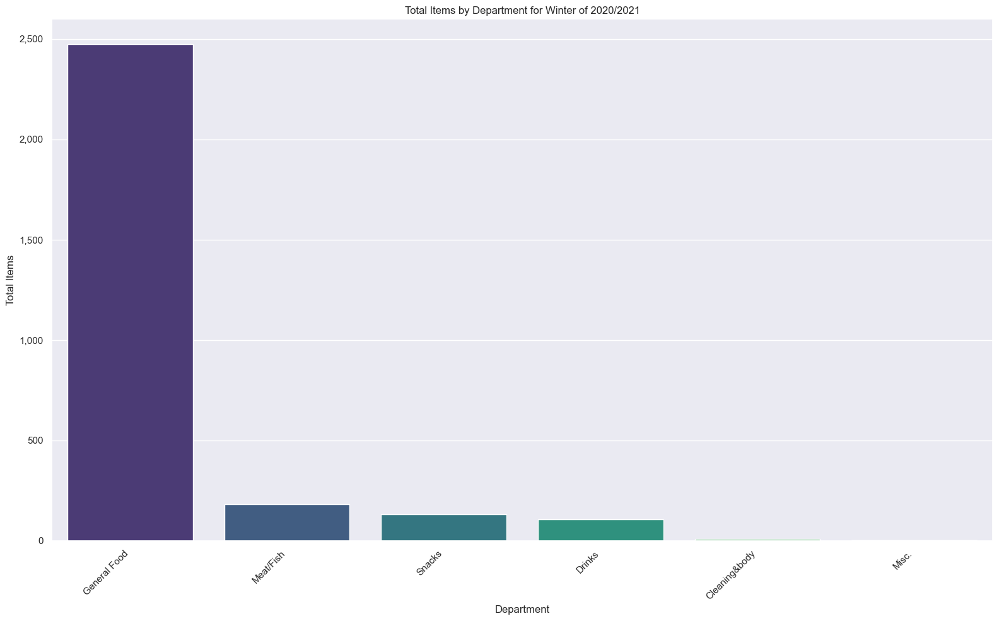

In [98]:
sum_items20_21 = df_winter20_21.groupby('Department')['Items'].sum().reset_index()
sum_items20_21 = sum_items20_21.sort_values('Items', ascending=False)


plt.figure(figsize=(16, 10))
sns.barplot(x='Department', y='Items', data=sum_items20_21, palette='viridis')  # Added a color palette
plt.xticks(rotation=45, ha="right")  # Rotated and aligned x-axis labels
plt.title("Total Items by Department for Winter of 2020/2021")
plt.xlabel("Department")
plt.ylabel("Total Items") #Added y axis label
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}')) # Format the y axis with $ and commas

plt.tight_layout() #adjusts plot parameters for a tight layout

plt.show()

<Axes: xlabel='Date'>

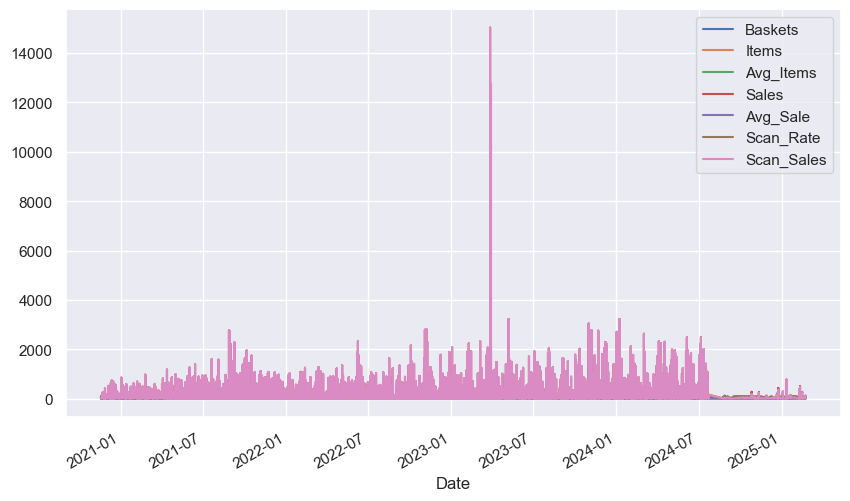

In [99]:
df["Date"] = pd.to_datetime(df["Date"])

df = df.set_index("Date")

df.plot()

In [100]:
df

,Department,Baskets,Items,Avg_Items,Sales,Avg_Sale,Scan_Rate,Scan_Sales
Date,,,,,,,,
2020-11-18,General Food,2,2,1.0,15.00,7.50,50.0,5.00
2020-11-18,Misc.,1,1,1.0,15.00,15.00,100.0,15.00
2020-11-20,General Food,4,6,1.5,19.50,4.87,100.0,19.50
2020-11-20,Misc.,1,1,1.0,15.00,15.00,100.0,15.00
2020-11-22,General Food,6,35,5.8,253.00,42.16,100.0,253.00
2020-11-22,Meat/Fish,3,12,4.0,160.00,53.33,100.0,160.00
2020-11-23,General Food,1,4,4.0,20.00,20.00,100.0,20.00
2020-11-23,Snacks,1,8,8.0,8.00,8.00,100.0,8.00
2020-11-24,General Food,5,34,6.8,223.00,44.60,100.0,223.00


In [101]:
df_food4 = df.drop(columns= ["Avg_Sale", "Scan_Sales", "Scan_Rate", "Baskets", "Items", "Avg_Items"])
df_food4

,Department,Sales
Date,,
2020-11-18,General Food,15.00
2020-11-18,Misc.,15.00
2020-11-20,General Food,19.50
2020-11-20,Misc.,15.00
2020-11-22,General Food,253.00
2020-11-22,Meat/Fish,160.00
2020-11-23,General Food,20.00
2020-11-23,Snacks,8.00
2020-11-24,General Food,223.00


In [103]:
# df_food3.columns = df_food3.columns.str.strip()
# df_food3.columns


In [ ]:
df['Date'] = pd.to_datetime(df['Date'], format='%Y-%m')
df.set_index('Date', inplace=True)

# Plot the original time series data
plt.figure(figsize=(7, 5))
plt.plot(df, label='Original Time Series')
plt.title('Inventory Time Series')
plt.xlabel('Year')
plt.ylabel('Number of Sales')
plt.legend()
plt.show()

In [ ]:
'''concatenate all 4 df's for seasons'''

# Here we explore a dataset that has specific product names and its respective department, the initial data we are working with does not have specific product names that are driving sales, so we can use this dataset to showcase how this can look like in the future for BeniFoods. This will help narrow the scope of how they can manage optimization with certian products in the future in terms of demand during the time of year.